# Webinar n°2: Pyleecan Advanced - Part 1: Optimization

This notebook is the support of the second out of three webinars organized by the association [Green Forge Coop](https://www.linkedin.com/company/greenforgecoop/about/) and the UNICAS University. 

The webinars schedule is:
- Friday 16th October 15h-17h (GMT+2): How to use pyleecan (basics)? Pyleecan basics, call of FEMM, use of the GUI
- Friday 30th October 15h-17h (GMT+1): How to use pyleecan (advanced)? Optimization tools, meshing, plot commands
- Friday 6th November 15h-17h (GMT+1): How to contribute to pyleecan? Github projects, Object Oriented Programming

Speakers: Pierre Bonneel, Hélène Toubin, Raphaël Pile from EOMYS.

This webinar will be recorded and the video will be shared on [pyleecan.org](https://pyleecan.org/tutorials.html)

To use this notebook please:
- Install Anaconda
- In Anaconda Prompt run the command "pip install pyleecan"
- Install the latest version of [femm](http://www.femm.info/wiki/Download) (windows only)
- In Anaconda Navigator, lanch Jupyter Notebook
- Jupyter Notebook should open a tab in your web brower, select this notebook to open it

To check if everything is correctly set, please run the following cell (WARNING: the webinar use pyleecan 1.0.2 and SciDataTool 1.1.5):

In [ ]:
%matplotlib notebook

# Print version of all packages
import pyleecan
print("Pyleecan version: "+pyleecan.__version__)

# Load the machine
from os.path import join
from pyleecan.Functions.load import load
from pyleecan.definitions import DATA_DIR

IPMSM_A = load(join(DATA_DIR, "Machine", "IPMSM_A.json"))
IPMSM_A.plot()

# Check FEMM installation
from pyleecan.Classes._FEMMHandler import FEMMHandler

femm = FEMMHandler()
femm.openfemm(0)


# 1) How to define a Parameter Sweep

## Reference Simulation

The first step to define a Parameter Sweep simulation in pyleecan is to define the "reference simulation". This webinar reuses the simulation from the first webinar: Prius machine with sinusoidal current and FEMM. The machine has been updated to use another Hole shematics (HoleM53) that enables to change the angle of the poles.

In [ ]:
%matplotlib notebook

# Import the machine defined in the GUI
from os.path import join
from pyleecan.Functions.load import load
from pyleecan.definitions import DATA_DIR

IPMSM_B = load("IPMSM_B.json")
IPMSM_B.plot()

In [ ]:
from pyleecan.Classes.Simu1 import Simu1
from pyleecan.Classes.MagFEMM import MagFEMM

# Initialization of the Simulation
simu_ref = Simu1(name="Webinar_2_ParamSweep", machine=IPMSM_B)

# Definition of the magnetic simulation (FEMM with symmetry and sliding band)
simu_ref.mag = MagFEMM(
    type_BH_stator=0,
    type_BH_rotor=0,
    is_periodicity_a=True,
    is_periodicity_t=True,
    Kgeo_fineness=1,
)
# Run only Magnetic module
simu_ref.elec = None
simu_ref.force = None
simu_ref.struct = None

In [ ]:
from pyleecan.Classes.InputCurrent import InputCurrent
from numpy import pi, sqrt
# Definition of a sinusoidal current
simu_ref.input = InputCurrent()
simu_ref.input.set_Id_Iq(I0=250 / sqrt(2), Phi0=140*pi/180)
simu_ref.input.Nt_tot = 128 # Number of time step
simu_ref.input.Na_tot = 2048 # Spatial discretization
simu_ref.input.N0 = 2000 # Rotor speed [rpm]

The result folder can be enforced with the following code. In this case, it will contain the FEMM files.

In [ ]:
from os import getcwd
from os.path import join

save_path = getcwd()  # Get notebook directory
simu_ref.path_result = join(save_path, "Simu_ref")
print(simu_ref.path_result)

The last release introduces the possibility to parallelize FEMM with:

In [ ]:
simu_ref.mag.nb_worker = 4

In [ ]:
out_ref = simu_ref.run()

print('Average Torque: '+str(out_ref.mag.Tem_av))

# Plot the flux and torque
out_ref.plot_2D_Data("mag.B","angle")
out_ref.plot_2D_Data("mag.Tem","time")

## ParamExplorer

*ParamExplorer* objects define which parameters to change in the reference simulation, and how they must change. *ParamExplorerSet* is a *ParamExplorer* daughter that enables to set the parameters variations from a list of values. The parameters to change are defined with a function (setter) which enables to do complex operations with the value as argument (cf example below). 

This setter can also be defined as a string to target directly a parameter. When generating the list of simulations to run, the function is executed before running the simulation to set the parameters as expected. The *ParamExplorerSet* has five attributes:

| Attribute | Type       | Description                                                                                        |
| --------- | ---------- | -------------------------------------------------------------------------------------------------- |
| name      | *str*      | name of the data                                                                                   |
| symbol    | *str*      | short name to access in *XOutput*                                                                  |
| unit      | *str*      | data unit                                                                                          |
| setter    | *function* | function that takes a *Simulation* and a <br/> value in argument and modifies the <br/> simulation |
| value     | *list*     | list that contains the different <br/> parameter values to explore                                 |

In the first example, the angle of the pole of the machine is updated from 0.85 to 1.2 rad and the magnet length from 14 to 17 mm:

In [ ]:
from pyleecan.Classes.ParamExplorerSet import ParamExplorerSet
from numpy import linspace

N_P1 = 2
N_P2 = 2

# Change W4 from 0.85 to 1.2
P1 = ParamExplorerSet(
        name = "Pole Angle",
        symbol = "W4",
        unit="rad",
        setter="simu.machine.rotor.hole[0].W4",
        value = linspace(0.85,1.2,N_P1,endpoint=True).tolist(),
    )

# Change W3 from 13e-3 to 17e-3
P2 = ParamExplorerSet(
        name = "Magnet Length",
        symbol = "W3",
        unit="m",
        setter="simu.machine.rotor.hole[0].W3",
        value = linspace(13e-3,17e-3,N_P2,endpoint=True).tolist(),
    )


print("P1.value: "+str(P1.value))
print("\nP2.value: "+str(P2.value))

## DataKeeper

Not all the output of all the simulations are saved in the XOutput. *DataKeeper* objects enable to specify which data to keep after each simulation by defining post-processing on *Output* object. A *DataKeeper* is a class with six attributes:

| Attribute    | Type       | Description                                                                                                                                                                                                         |
| ------------ | ---------- | ------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------- |
| name         | *str*      | name of the data                                                                                                                                                                                                    |
| symbol       | *str*      | short name to access in *XOutput*                                                                                                                                                                                   |
| unit         | *str*      | data unit                                                                                                                                                                                                           |
| keeper       | *function* | function that takes an *Output* in argument and  <br/> returns a value                                                                                                                                              |
| error_keeper | *function* | function that takes a *Simulation* in argument and <br/> returns a value, this attribute permits to handle <br/> errors and  to put NaN values in the result matrices |
| result       | *list*     | list containing DataKeeper results for each simulation                                                                                                                                                              |

This following datakeepers enable to store the average torque and the radial magnetic flux for all the simulations:

In [ ]:
from pyleecan.Classes.DataKeeper import DataKeeper
# Store the torque
D1 = DataKeeper(
        name = "Average Torque",
        unit = "N.m", 
        symbol = "Tem_av",
        keeper = "lambda output: output.mag.Tem_av",
        error_keeper = "lambda simu: np.nan",
    )
#Store radial flux
D2 = DataKeeper(
        name = "Radial Magnetic Flux",
        unit = "H",
        symbol = "Br",
        keeper = 'lambda output: output.mag.B.components["radial"].get_along("time","angle")["B_r"]',
        error_keeper = "lambda simu: np.nan * np.zeros((3,2048))",
        )

## VarParam
Finally a *VarParam* object (that inherits from an abstract *VarSimu* class) is set as a property of the reference simulation object. *VarParam* object defines how to generate the simulation list and which data to gather. To do so, *VarParam* class
contains :


| Attribute          | Type                | Description                                                                                               |
| ------------------ | ------------------- | --------------------------------------------------------------------------------------------------------- |
| paramexplorer_list | *\[ParamExplorer\]* | simulation parameters to variate                                                                          |
| datakeeper_list    | *\[DataKeeper\]*    | output data to keep                                                                                       |
| is_keep_all_output | *bool*              | True to keep every output                                                                                 |
| stop_if_error      | *bool*              | error tolerance                                                                                           |
| ref_simu_index     | *int*               | Index of the reference  simulation, if None the <br/> reference simulation is not in the multi-simulation |
| nb_simu            | *int*               | number of simulations (will be set during run)                                                                                     |


In [ ]:
from pyleecan.Classes.VarParam import VarParam
simu2 = simu_ref.copy()
simu2.input.Nt_tot = 64  # Reduce the number of time step before ParamSweep

var = VarParam(
    paramexplorer_list=[P1,P2],  # 2 Param explorer W3 and W4
    datakeeper_list=[D1,D2],  # 2 Datakeeper Tem_av and Br
    is_keep_all_output=False,  # Only the Datakeeper at the end
    stop_if_error=False,  # If error, use DataKeeper method
    is_reuse_femm_file=False,  # Geometry is changed so the FEMM file can't be reuse
    ref_simu_index=None)  # The reference simulation is not part of the var-simu

simu2.var_simu = var

To show the modification on the machine, two post-processings are set. 

The first one on the Simulation object saves the plot of the machine and torque (as machine_X.png with X the id of the simulation). This post-processing will be called at the end of each simulation. 

The second one is set on the VarSimu object and will be called once all the simulation are run. It generates a gif from all the files.

Both postprocessings are defined in a dedicated python file and set with the path to the file.

In [ ]:
# Set Post Processing
from pyleecan.Classes.PostFunction import PostFunction

# Save plot for each simulation
Post1 = PostFunction("plot_save.py")
simu2.postproc_list = [Post1]

# Generate gif once all the simulation are done
Post2 = PostFunction("make_gif.py")
simu2.var_simu.postproc_list = [Post2]

Finally the Simulation is run as usual with:

In [ ]:
simu2.path_result = join(save_path, "Simu_Hole")
xout2 = simu2.run()

In [ ]:
from numpy import argmax
print("Values available in XOutput:")
print(xout2.xoutput_dict.keys())

print("\nThe design variables were:")
for param_exp in xout2.paramexplorer_list:
    print(param_exp.name+" ("+param_exp.symbol+"): "+str(param_exp.value))

print("\nAverage torque for each simulation:")
print(xout2["Tem_av"].result)

T_max_index = argmax(xout2["Tem_av"].result)
print("\nThe torque is maximum for the simulation n°"+str(T_max_index))

best_simu = xout2.get_simu(T_max_index)
print("Ref W4: "+str(simu2.machine.rotor.hole[0].W4)+", W3: "+str(simu2.machine.rotor.hole[0].W3))
print("Best W4: "+str(best_simu.machine.rotor.hole[0].W4)+", W3: "+str(best_simu.machine.rotor.hole[0].W3))
best_simu.machine.plot()
xout2.plot_multi("W4","Tem_av")

Before the webinar, the simulation was run with
- Nt_tot=128
- P1.value: [0.85, 0.9, 0.95, 1.0, 1.05, 1.0999999999999999, 1.15, 1.2]
- P2.value: [0.013, 0.014333333333333333, 0.01566666666666667, 0.017]

The torque is maximum for the simulation n°23

Ref W4: 1.16599, W3: 0.017

Best W4: 1.0999999999999999, W3: 0.017

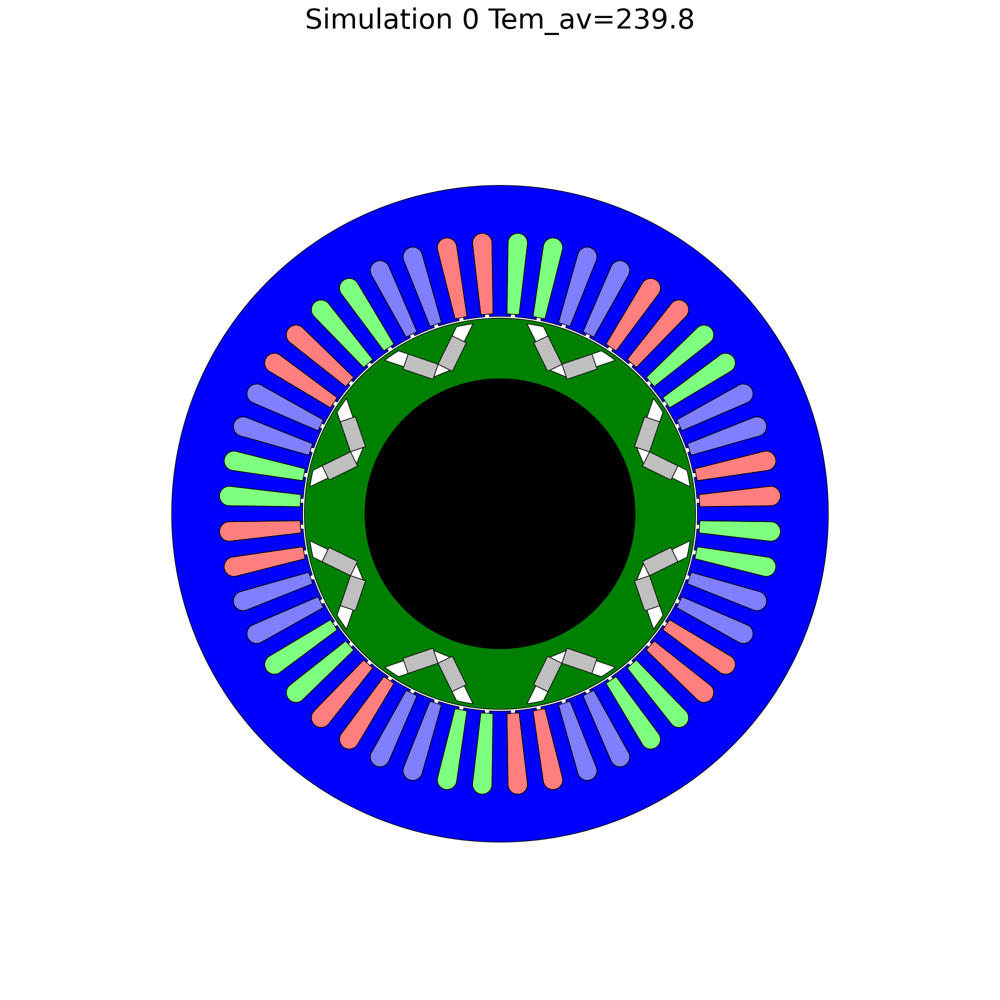

## Complex Parameter Sweep: Slot scaling
As ParamExplorer and DataKeepers are set with functiond, there is no limit to the modification/computation that can be done by these objects. This enables to define some advanced simulation:

In [ ]:
from pyleecan.Classes.ParamExplorerSet import ParamExplorerSet
from numpy import linspace
N_simu = 8

# scale_plot.py multiply all property of the slot with value
P3 = ParamExplorerSet(
        name = "Scaling Factor",
        symbol = "k",
        unit="-",
        setter="scale_slot.py",
        value = linspace(0.8,1.5,N_simu,endpoint=True).tolist(),
    )
print("P3.value: "+str(P3.value))


One can also set a function for Datakeeper, to do some advanced post-processing.

In this example, the 3rd simulation (index=2) matches exactly the reference simulation (scaling factor=1). To avoid running it twice, the property "ref_simu_index" can be set. Then the 3rd simulation will be run first then all the others.

In [ ]:
from pyleecan.Classes.VarParam import VarParam
simu3 = simu_ref.copy()
simu3.input.Nt_tot = 64

# Definition of Parameter Sweep
var = VarParam(
    paramexplorer_list=[P3],  # One parameter explorer: scalling slot
    datakeeper_list=[D1,D2],  # 2 Datakeeper Tem_av and Br 
    is_keep_all_output=False,  # Only the Datakeeper at the end
    stop_if_error=False,  # If error, use DataKeeper method    
    is_reuse_femm_file=False,  # Geometry is changed so the FEMM file can't be reuse
    ref_simu_index=2)  # The reference simulation is part of the var-simu
simu3.var_simu = var
    
# Set Post Processing
simu3.postproc_list = [Post1]  #Save plot
simu3.var_simu.postproc_list = [Post2]  #Create Gif

In [ ]:
simu3.path_result = join(save_path, "Simu_Slot")
xout3 = simu3.run()

P3.value: [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0, 1.05, 1.1, 1.15, 1.2000000000000002, 1.25, 1.3, 1.35, 1.4, 1.4500000000000002, 1.5, 1.55, 1.6]

Note: k=1.6 raise an error. The last post-processing is not called (so there is a missing simulation in the Gif) and xout3["Tem_av"].result[-1] = nan as expected.
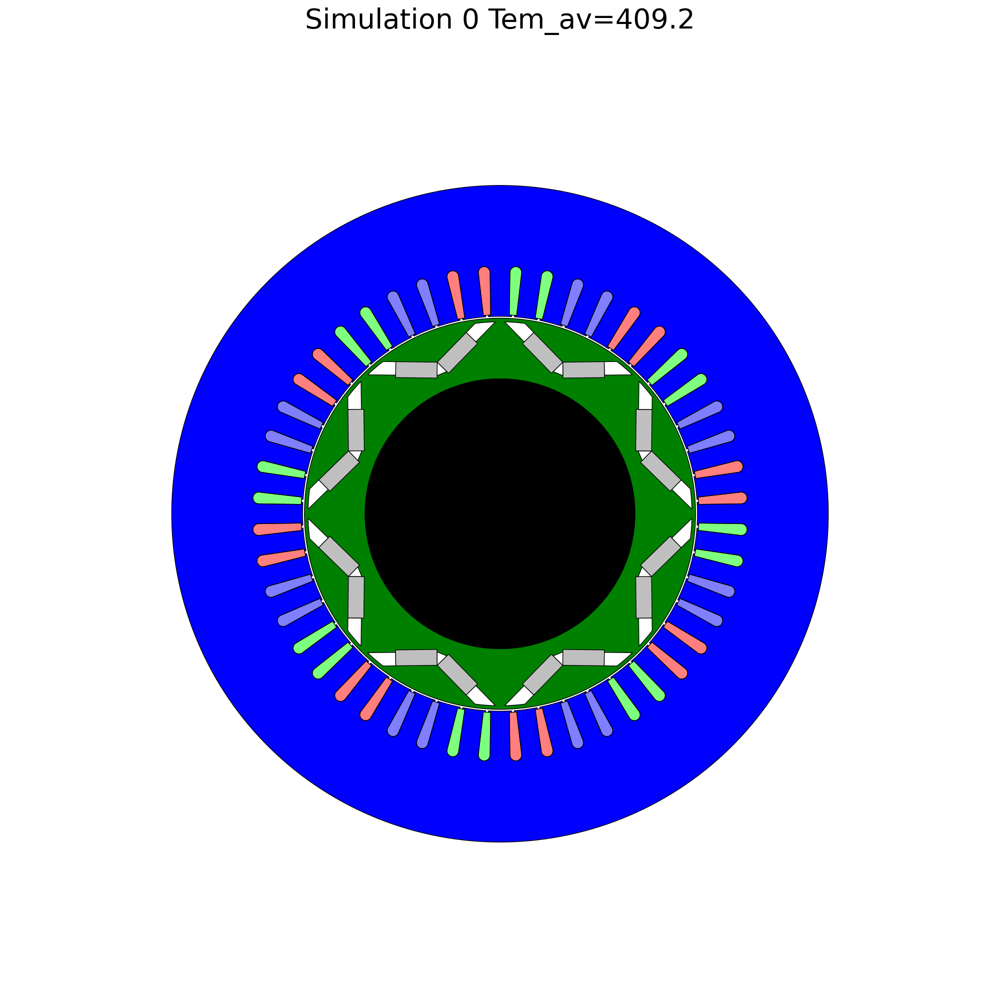

# Optimization


## Problem definition

The object [**OptiProblem**](https://www.pyleecan.org/pyleecan.Classes.OptiObjFunc.html) contains all the optimization problem characteristics:  

- A reference simulation
- the design variables to vary some parameters of the simulation (e.g. input current, topology of the machine)  
- the objective functions to minimize for the simulation  
- some constraints (optional)  

## Reference simulation definition

To define the problem, we first define the default simulation. The optimization process will be based on this simulation, each evaluation will copy it, set the value of the design variables and run the new simulation.

In [ ]:
simu_ref_2 = simu_ref.copy()

IPMSM_A = load(join(DATA_DIR, "Machine", "IPMSM_A.json"))
simu_ref_2.machine = IPMSM_A

simu_ref_2.input.Nt_tot = 64

## Minimization problem definition

To setup the optimization problem, we define some objective functions using the [**DataKeeper**](https://www.pyleecan.org/pyleecan.Classes.DataKeeper.html) object. 

Each objective function is stored in the *keeper* attribute of a **DataKeeper**. This type of function takes an output object in argument and returns a float to **minimize**. 
We gather the objective functions into a list.

In [ ]:
from pyleecan.Classes.DataKeeper import DataKeeper

obj_list = [
    DataKeeper(
        name="Maximization of the average torque",
        symbol="Tem_av",
        unit="N.m",
        keeper="lambda output: -abs(output.mag.Tem_av)",
    ),
    DataKeeper(
        name="Minimization of the first torque harmonic",
        symbol="Tem_rip_pp",
        unit="N.m",
        keeper="lambda output: abs(output.mag.Tem_rip_pp)",
    ),
]

## Design variables
We use the object [**OptiDesignVar**](https://www.pyleecan.org/pyleecan.Classes.OptiDesignVar.html) to define the design variables. 


To define a design variable, we have to specify different attributes:  

- *name* to define the design variable name
- *symbol* to access to the variable
- *unit* to define the variable unit
- *type_var* to specify the variable "type":  
    - *interval* for continuous variables  
    - *set* for discrete variables  
- *space* to set the variable bound
- *setter* to access the variable in the output's simu object. This attribute **must begin by "simu"**.  
- *get_value* to define the variable for the first generation, the function takes the space in argument and returns the variable value  

We store the design variables in a dictionnary that will be in argument of the problem. For this example, we define two design variables: 

1. Stator slot opening: can be any value between 0 and the current slot width.   
2. Rotor magnet width: can be one of the four value specified 11, 13, 15, 17 mm

In [ ]:
from pyleecan.Classes.OptiDesignVar import OptiDesignVar
import random

# Design variables
my_design_var = [
    # Stator slot opening in interval
    OptiDesignVar(
        name="Stator slot opening",
        symbol = "SW0",
        unit = "m",
        type_var="interval",
        space=[
            0,
            simu_ref_2.machine.stator.slot.W2,
        ],
        get_value="lambda space: random.uniform(*space)", # To initiate randomly the first generation
        setter="simu.machine.stator.slot.W0", # Variable to edit
    ),
    # Magnet Width within 4 values
    OptiDesignVar(
        name= "Magnet Width",
        symbol = "W4",
        unit = "m",
        type_var="set",
        space=[
            11e-3,
            13e-3,
            15e-3,
            17e-3,
        ],
        get_value="lambda space: random.choice(space)",
        setter = "simu.machine.rotor.hole[0].W4"
    ),
]

### Constraints

The class [**OptiConstraint**](https://www.pyleecan.org/pyleecan.Classes.OptiConstraint.html) enables to define some constraints. For each constraint, we have to define the following attributes:  

- name  
- type_const: type of constraint  
    - "=="  
    - "<="  
    - "<"  
    - ">="  
    - ">"  
- value: value to compare  
- get_variable: function which takes output in argument and returns the constraint value  

We also store the constraints into a list.

In [ ]:
from pyleecan.Classes.OptiConstraint import OptiConstraint
my_constraint = [
    OptiConstraint(
        name = "const1",
        type_const = "<=",
        value = 75,
        get_variable = "lambda output: abs(output.mag.Tem_rip_pp)",
    )
]

## Evaluation function


We can create our own evaluation function if needed by defining a function which only takes an output in argument. 

For this example we keep the default one which calls the `simu.run` method. 

In [ ]:
from pyleecan.Classes.OptiProblem import OptiProblem


# Problem creation
my_prob = OptiProblem(
    simu=simu_ref_2,  #Reference simu
    design_var=my_design_var, # Design variable SW0 and Rext
    obj_func=obj_list,  # DataKeeper Tem_av
    constraint = my_constraint,  # Constrains output.mag.Tem_rip_pp <= 700
    eval_func = None # To keep the default evaluation function
)

## Solver

The class [**OptiGenAlgNsga2**](https://www.pyleecan.org/pyleecan.Classes.OptiGenAlgNsga2Deap.html) enables to solve our problem using [NSGA-II](https://www.iitk.ac.in/kangal/Deb_NSGA-II.pdf) genetical algorithm. The algorithm takes several parameters:  

|Parameter|Description|Type|Default Value|  
| :-: | :- | :-: | :-: |  
|*problem*|Problem to solve|**OptiProblem**|mandatory|
|*size\_pop*| Population size per generation|**int**|40|  
|*nb\_gen*|Generation number|**int**|100|  
|*p\_cross*|Crossover probability|**float**|0.9|  
|*p\_mutate*|Mutation probability|**float**|0.1|  

  
The `solve` method performs the optimization and returns an [**OutputMultiOpti**](https://www.pyleecan.org/pyleecan.Classes.OutputMultiOpti.html) object which contains the results.

In [ ]:
from pyleecan.Classes.OptiGenAlgNsga2Deap import OptiGenAlgNsga2Deap

# Solve problem with NSGA-II
solver = OptiGenAlgNsga2Deap(problem=my_prob, size_pop=20, nb_gen=10, p_mutate=0.5)
xout4 = solver.solve()

During the algorithm the object displays some data containing:

- number of errors: failure during the objective function execution
- number of infeasible: number of individual with constraints violations

## Save/load h5
In pyleecan all the objects have a save method. This method takes two arguments:
    - save_path: Path to save the object
    - is_folder: to split the object in different files (separate simulation machine and materials)
save_path can end either in "json" or "h5". json is for objects to read/edit (machine, simulation, materials), h5 is for data.

In [ ]:
simu_ref.save(save_path=join(save_path,"Reference_simu.json"), is_folder=True)
simu_ref2 = load(join(save_path,"Reference_simu", "Reference_simu.json"))

xout4.save(join(save_path,"opti_out.h5"))

In [ ]:
res = load("opti_out.h5")

from numpy import argmin
print("Values available in XOutput:")
print(res.xoutput_dict.keys())
print("\ngen:")
print(res["ngen"].result)

print("\nis_valid:")
print(res["is_valid"].result)

print("\nThe design variables were:")
for param_exp in res.paramexplorer_list:
    print(param_exp.name+" ("+param_exp.symbol+"): "+str(param_exp.value))

print("\nAverage torque for each simulation:")
print(res["Tem_av"].result)

T_max_index = argmin(res["Tem_av"].result)
print("\nThe torque is maximum for the simulation n°"+str(T_max_index))

best_simu = res.get_simu(T_max_index)
print("Ref W4: "+str(simu_ref_2.machine.rotor.hole[0].W4)+", SW0: "+str(simu_ref_2.machine.stator.slot.W0))
print("Best W4: "+str(best_simu.machine.rotor.hole[0].W4)+", SW0: "+str(best_simu.machine.stator.slot.W0))
best_simu.machine.plot()

## Plot results

**OutputMultiOpti** has several methods to display some results:  

- `plot_generation`: to plot individuals for in 2D  
- `plot_pareto`: to plot the pareto front in 2D    

In [ ]:
%matplotlib notebook 
import matplotlib.pyplot as plt 

# Create a figure containing 4 subfigures (axes) 
fig, axs = plt.subplots(2,2, figsize=(8,8))

# Plot every individual in the fitness space 
res.plot_generation(
    x_symbol = "Tem_av", # symbol of the first objective function or design variable
    y_symbol = "Tem_rip_pp", # symbol of the second objective function or design variable
    ax = axs[0,0] # ax to plot
)

# Plot every individual in the design space 
res.plot_generation(
    x_symbol = "SW0", 
    y_symbol = "W4", 
    ax = axs[0,1]
)

# Plot pareto front in fitness space 
res.plot_pareto(
    x_symbol = "Tem_av", 
    y_symbol = "Tem_rip_pp", 
    ax = axs[1,0]
)

# Plot pareto front in design space 
res.plot_pareto(
    x_symbol = "SW0", 
    y_symbol = "W4", 
    ax = axs[1,1]
)

fig.tight_layout()
